In [1]:
import pandas as pd 
import seaborn as sns
import matplotlib.pyplot as plt
import os
from dotenv import load_dotenv

In [2]:
load_dotenv()
folder_path = os.getenv('DATASETS_FOLDER_PATH')
filename = 'yfinance_correlation.csv'
stock_returns_file_path = os.path.join(folder_path, filename)

In [3]:
data = pd.read_csv('D:\MANU\Datasets\yfinance_correlation_data.csv')

In [4]:
# data.head()
# len(data)
# pivot_df = data.pivot(index='date', columns='Name', values='log_returns')
# pivot_df.head()
# type(pivot_df)

In [5]:
data.head()

,Date,A,AAL,AAP,AAPL,ABBV,ABMD,ABT,ACN,ADBE,...,WYNN,XEL,XOM,XRAY,XYL,YUM,ZBH,ZBRA,ZION,ZTS
0,2022-01-05,-0.017279,-0.018038,-0.002534,-0.026960,0.005239,-0.066873,-0.004503,-0.017768,-0.074105,...,-0.037736,0.009752,0.012361,-0.016220,-0.013723,-0.012757,-0.003302,-0.051365,0.002268,-0.038766
1,2022-01-06,0.003493,-0.005906,0.021753,-0.016834,-0.004722,-0.005218,-0.000148,-0.049495,-0.000603,...,0.004618,-0.007852,0.023248,-0.000711,-0.001374,0.010277,-0.008342,-0.005425,0.040254,0.003963
2,2022-01-07,-0.026984,0.037521,-0.014842,0.000988,-0.002592,-0.052351,0.003103,-0.019366,-0.006674,...,-0.001064,0.008721,0.008163,0.003197,-0.008025,-0.011533,-0.006068,-0.044758,0.016543,-0.029546
3,2022-01-10,0.000069,-0.025743,-0.016772,0.000116,0.011133,-0.039872,-0.002215,0.006051,0.029196,...,-0.028553,0.010938,-0.005970,-0.016987,-0.010188,-0.014062,-0.009802,0.008534,-0.007590,0.007128
4,2022-01-11,0.010144,0.012166,-0.009096,0.016644,0.004244,0.039309,0.003248,0.005641,0.007691,...,0.037384,-0.018201,0.041202,0.015745,0.016750,-0.021203,0.011595,0.005885,0.009444,0.000940


In [6]:
correlation_matrix = data.corr()
print(correlation_matrix)

             A       AAL       AAP      AAPL      ABBV      ABMD       ABT  \
A     1.000000  0.415947  0.396411  0.655216  0.326661  0.473796  0.692897   
AAL   0.415947  1.000000  0.390926  0.581735  0.152761  0.366425  0.460523   
AAP   0.396411  0.390926  1.000000  0.441613  0.323692  0.247778  0.388580   
AAPL  0.655216  0.581735  0.441613  1.000000  0.239764  0.370459  0.622515   
ABBV  0.326661  0.152761  0.323692  0.239764  1.000000  0.177843  0.459111   
...        ...       ...       ...       ...       ...       ...       ...   
YUM   0.579390  0.540989  0.367407  0.578849  0.249029  0.392236  0.584909   
ZBH   0.556995  0.491431  0.380140  0.562796  0.321746  0.409107  0.626230   
ZBRA  0.605694  0.507925  0.426876  0.707449  0.175488  0.130192  0.578556   
ZION  0.496399  0.554438  0.406361  0.562970  0.262905  0.257799  0.581406   
ZTS   0.710453  0.396480  0.433035  0.667108  0.398008  0.429427  0.700433   

           ACN      ADBE       ADI  ...      WYNN       XEL    

C:\Users\stefa\AppData\Local\Temp\ipykernel_4956\4203189485.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_matrix = data.corr()


In [7]:
# plt.figure(figsize=(100, 100))
# sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=.5)
# plt.show()

In [8]:
import networkx as nx

In [9]:
G = nx.Graph()

G.add_nodes_from(correlation_matrix.index)

for i in range(len(correlation_matrix.index)):
    for j in range(i+1, len(correlation_matrix.index)):
        company1 = correlation_matrix.index[i]
        company2 = correlation_matrix.index[j]
        correlation_coefficient = correlation_matrix.loc[company1, company2]
        G.add_edge(company1, company2, weight=correlation_coefficient)


In [10]:
G.number_of_edges()

114481

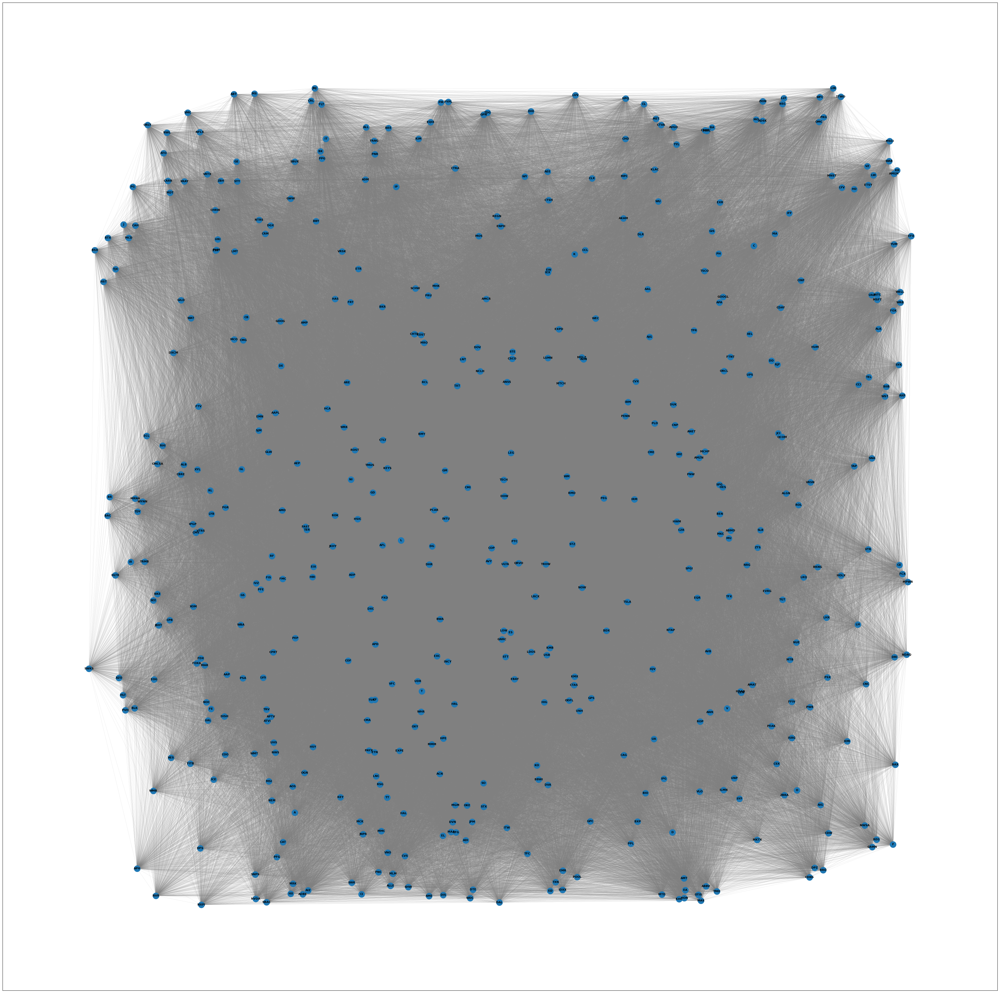

In [11]:
plt.figure(figsize=(50, 50))

pos = nx.random_layout(G)
nx.draw_networkx(G, pos, with_labels=True, font_size=8, font_color="black", font_weight="bold", edge_color="gray", width=0.1)

# Show the plot
plt.show()

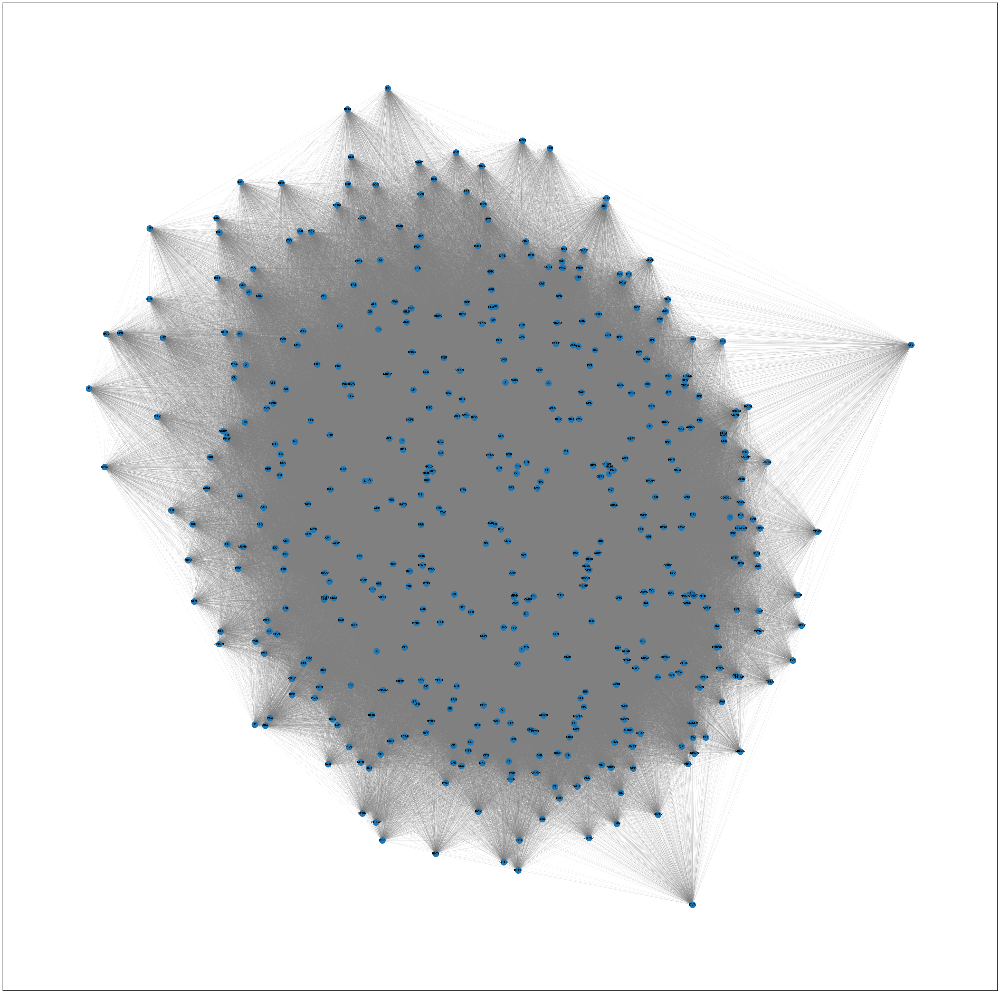

In [12]:
plt.figure(figsize=(50, 50))

pos = nx.spring_layout(G)
nx.draw_networkx(G, pos, with_labels=True, font_size=8, font_color="black", font_weight="bold", edge_color="gray", width=0.1)

# Show the plot
plt.show()

In [13]:
# Print nodes and their attributes
print("Nodes:")
for node_id, attributes in G.nodes(data=True):
    print(f"Node {node_id}: {attributes}")

# Print edges and their attributes
print("\nEdges:")
for edge in G.edges(data=True):
    print(f"Edge {edge[:2]}: {edge[2]}")

Nodes:
Node A: {}
Node AAL: {}
Node AAP: {}
Node AAPL: {}
Node ABBV: {}
Node ABMD: {}
Node ABT: {}
Node ACN: {}
Node ADBE: {}
Node ADI: {}
Node ADM: {}
Node ADP: {}
Node ADSK: {}
Node AEE: {}
Node AEP: {}
Node AES: {}
Node AFL: {}
Node AIG: {}
Node AIZ: {}
Node AJG: {}
Node AKAM: {}
Node ALB: {}
Node ALGN: {}
Node ALK: {}
Node ALL: {}
Node ALLE: {}
Node AMAT: {}
Node AMCR: {}
Node AMD: {}
Node AME: {}
Node AMGN: {}
Node AMP: {}
Node AMT: {}
Node AMZN: {}
Node ANET: {}
Node ANSS: {}
Node AON: {}
Node AOS: {}
Node APA: {}
Node APD: {}
Node APH: {}
Node APTV: {}
Node ARE: {}
Node ATO: {}
Node ATVI: {}
Node AVB: {}
Node AVGO: {}
Node AVY: {}
Node AWK: {}
Node AXP: {}
Node AZO: {}
Node BA: {}
Node BAC: {}
Node BAX: {}
Node BBWI: {}
Node BBY: {}
Node BDX: {}
Node BEN: {}
Node BIIB: {}
Node BIO: {}
Node BK: {}
Node BKNG: {}
Node BKR: {}
Node BLK: {}
Node BMY: {}
Node BR: {}
Node BRO: {}
Node BSX: {}
Node BWA: {}
Node BXP: {}
Node C: {}
Node CAG: {}
Node CAH: {}
Node CARR: {}
Node CAT: {}
Node

In [14]:
load_dotenv()
sp500_csv_file_path = os.getenv('SP500_CSV_FILE_PATH')
sp500_df = pd.read_csv(sp500_csv_file_path)

In [15]:
sp500_df.set_index('Symbol', inplace=True)
print(sp500_df)

                       Name                  Sector
Symbol                                             
MMM                      3M             Industrials
AOS             A. O. Smith             Industrials
ABT     Abbott Laboratories             Health Care
ABBV                 AbbVie             Health Care
ABMD                Abiomed             Health Care
...                     ...                     ...
YUM             Yum! Brands  Consumer Discretionary
ZBRA     Zebra Technologies  Information Technology
ZBH           Zimmer Biomet             Health Care
ZION          Zions Bancorp              Financials
ZTS                  Zoetis             Health Care

[505 rows x 2 columns]


In [16]:
symbol_attributes = sp500_df[['Name', 'Sector']].to_dict(orient='index')

In [17]:
symbol_attributes

{'MMM': {'Name': '3M', 'Sector': 'Industrials'},
 'AOS': {'Name': 'A. O. Smith', 'Sector': 'Industrials'},
 'ABT': {'Name': 'Abbott Laboratories', 'Sector': 'Health Care'},
 'ABBV': {'Name': 'AbbVie', 'Sector': 'Health Care'},
 'ABMD': {'Name': 'Abiomed', 'Sector': 'Health Care'},
 'ACN': {'Name': 'Accenture', 'Sector': 'Information Technology'},
 'ATVI': {'Name': 'Activision Blizzard', 'Sector': 'Communication Services'},
 'ADM': {'Name': 'ADM', 'Sector': 'Consumer Staples'},
 'ADBE': {'Name': 'Adobe', 'Sector': 'Information Technology'},
 'AAP': {'Name': 'Advance Auto Parts', 'Sector': 'Consumer Discretionary'},
 'AMD': {'Name': 'Advanced Micro Devices', 'Sector': 'Information Technology'},
 'AES': {'Name': 'AES Corp', 'Sector': 'Utilities'},
 'AFL': {'Name': 'Aflac', 'Sector': 'Financials'},
 'A': {'Name': 'Agilent Technologies', 'Sector': 'Health Care'},
 'APD': {'Name': 'Air Products & Chemicals', 'Sector': 'Materials'},
 'AKAM': {'Name': 'Akamai Technologies', 'Sector': 'Informat

In [18]:
nx.set_node_attributes(G, symbol_attributes)

In [19]:
print("Nodes:")
for node_id, attributes in G.nodes(data=True):
    print(f"Node {node_id}: {attributes}")


Nodes:
Node A: {'Name': 'Agilent Technologies', 'Sector': 'Health Care'}
Node AAL: {'Name': 'American Airlines Group', 'Sector': 'Industrials'}
Node AAP: {'Name': 'Advance Auto Parts', 'Sector': 'Consumer Discretionary'}
Node AAPL: {'Name': 'Apple', 'Sector': 'Information Technology'}
Node ABBV: {'Name': 'AbbVie', 'Sector': 'Health Care'}
Node ABMD: {'Name': 'Abiomed', 'Sector': 'Health Care'}
Node ABT: {'Name': 'Abbott Laboratories', 'Sector': 'Health Care'}
Node ACN: {'Name': 'Accenture', 'Sector': 'Information Technology'}
Node ADBE: {'Name': 'Adobe', 'Sector': 'Information Technology'}
Node ADI: {'Name': 'Analog Devices', 'Sector': 'Information Technology'}
Node ADM: {'Name': 'ADM', 'Sector': 'Consumer Staples'}
Node ADP: {'Name': 'Automatic Data Processing', 'Sector': 'Information Technology'}
Node ADSK: {'Name': 'Autodesk', 'Sector': 'Information Technology'}
Node AEE: {'Name': 'Ameren Corp', 'Sector': 'Utilities'}
Node AEP: {'Name': 'American Electric Power', 'Sector': 'Utilitie

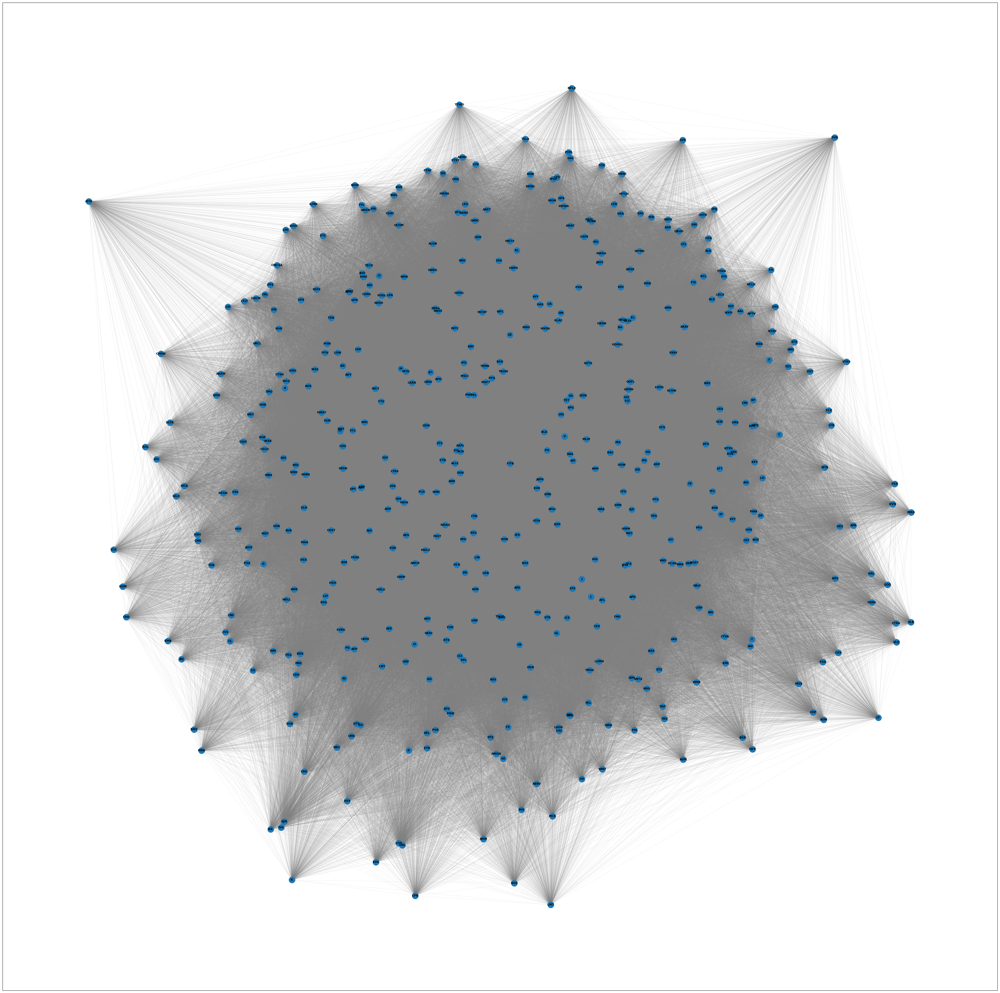

In [20]:
plt.figure(figsize=(50, 50))

pos = nx.spring_layout(G)
nx.draw_networkx(G, pos, with_labels=True, font_size=8, font_color="black", font_weight="bold", edge_color="gray", width=0.1)

plt.show()

In [21]:
nx.write_graphml(G, "../Graphs/pearson_correlation_full_graph.graphml")